# Complete Movement Analysis: Position, Velocity, and Acceleration
This notebook demonstrates how to load, analyze, and visualize complete trajectory data that includes position, velocity, and acceleration information.

In [1]:
# Import our modules
import numpy as np
import matplotlib.pyplot as plt
from trajectory_data import TrajectoryData
from trajectory_collection import TrajectoryCollection
from trajectory_visualizer import (
    MatplotlibVisualizer,
    FoliumMapVisualizer,
    PlotlyAnimationVisualizer
)
from trajectory_anomaly_detector import TrajectoryQualityAnalyzer

/Users/mgerard8/Library/Python/3.9/lib/python/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


## Load and Examine Comprehensive Trajectory Data

In [2]:
# Define the path to the MATLAB data file
data_file_path = "FORDDAT2_20250414_Target45deg_Tilt-ive_60kph__093931_001.mat"

# Load the trajectory data
trajectory = TrajectoryData(data_file_path)

# Display position information
position_stats = trajectory.get_coordinate_stats()
print("Position Information:")
print(f"Number of trajectory points: {position_stats['num_points']}")
print(f"Latitude range: {position_stats['lat_range'][0]} to {position_stats['lat_range'][1]}")
print(f"Longitude range: {position_stats['lon_range'][0]} to {position_stats['lon_range'][1]}")
print(f"Time range: {position_stats['time_range']} seconds")

# Display velocity information
velocity_stats = trajectory.get_velocity_stats()
print("\nVelocity Information:")
if velocity_stats.get("available", False):
    print(f"Average Speed: {velocity_stats['avg_speed']:.2f}")
    print(f"Maximum Speed: {velocity_stats['max_speed']:.2f}")
    print(f"Maximum North Velocity: {velocity_stats['max_vel_north']:.2f}")
    print(f"Maximum East Velocity: {velocity_stats['max_vel_east']:.2f}")
    print(f"Maximum Down Velocity: {velocity_stats['max_vel_down']:.2f}")
    
    if velocity_stats.get("units"):
        print(f"\nVelocity Units:")
        for component, unit in velocity_stats["units"].items():
            print(f"  {component}: {unit}")
else:
    print("No velocity data available in this file.")
    
# Display acceleration information
accel_stats = trajectory.get_acceleration_stats()
print("\nAcceleration Information:")
if accel_stats.get("available", False):
    print(f"Average Acceleration Magnitude: {accel_stats['avg_accel_magnitude']:.2f}")
    print(f"Maximum Acceleration Magnitude: {accel_stats['max_accel_magnitude']:.2f}")
    print(f"Maximum X Acceleration: {accel_stats['max_accel_x']:.2f}")
    print(f"Maximum Y Acceleration: {accel_stats['max_accel_y']:.2f}")
    print(f"Maximum Z Acceleration: {accel_stats['max_accel_z']:.2f}")
    
    if accel_stats.get("units"):
        print(f"\nAcceleration Units:")
        for component, unit in accel_stats["units"].items():
            print(f"  {component}: {unit}")
else:
    print("No acceleration data available in this file.")

Position Information:
Number of trajectory points: 4501
Latitude range: 42.297544699999996 to 42.2995899
Longitude range: -83.222118 to -83.2151506
Time range: 44.999393000000055 seconds

Velocity Information:
Average Speed: 13.74
Maximum Speed: 17.18
Maximum North Velocity: 6.44
Maximum East Velocity: 15.94
Maximum Down Velocity: 0.18

Velocity Units:
  vel_north: m/s
  vel_east: m/s
  vel_down: m/s
  speed_3d: m/s

Acceleration Information:
Average Acceleration Magnitude: 9.86
Maximum Acceleration Magnitude: 11.65
Maximum X Acceleration: 3.59
Maximum Y Acceleration: 2.16
Maximum Z Acceleration: 11.65

Acceleration Units:
  accel_x: m/s2
  accel_y: m/s2
  accel_z: m/s2


## Visualize Acceleration Components

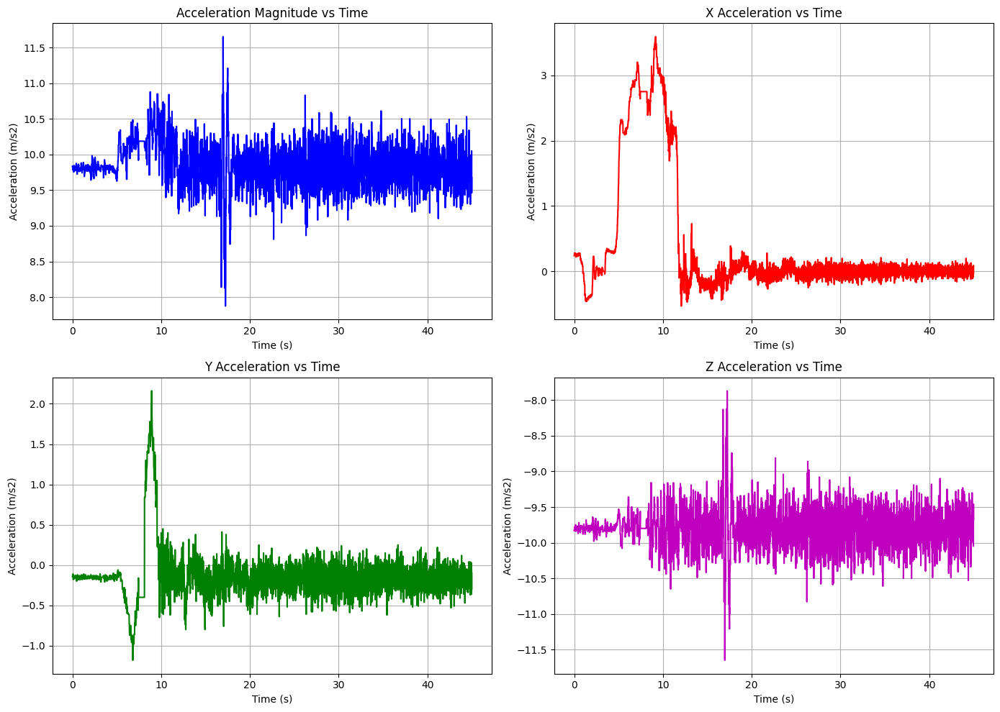

In [3]:
# Only create acceleration visualization if data is available
if accel_stats.get("available", False):
    # Calculate acceleration magnitude
    accel_magnitude = np.sqrt(
        trajectory.accel_x**2 + 
        trajectory.accel_y**2 + 
        trajectory.accel_z**2
    )
    
    # Create time array for x-axis (relative to start)
    accel_time_diff = trajectory.acceleration_time - trajectory.acceleration_time[0]
    
    fig, axs = plt.subplots(2, 2, figsize=(14, 10))
    
    # Plot acceleration magnitude
    axs[0, 0].plot(accel_time_diff, accel_magnitude, 'b-')
    axs[0, 0].set_title('Acceleration Magnitude vs Time')
    axs[0, 0].set_xlabel('Time (s)')
    unit_label = accel_stats["units"]["accel_x"] if accel_stats.get("units") else "units"
    axs[0, 0].set_ylabel(f'Acceleration ({unit_label})')
    axs[0, 0].grid(True)
    
    # Plot X acceleration component
    axs[0, 1].plot(accel_time_diff, trajectory.accel_x, 'r-')
    axs[0, 1].set_title('X Acceleration vs Time')
    axs[0, 1].set_xlabel('Time (s)')
    axs[0, 1].set_ylabel(f'Acceleration ({unit_label})')
    axs[0, 1].grid(True)
    
    # Plot Y acceleration component
    axs[1, 0].plot(accel_time_diff, trajectory.accel_y, 'g-')
    axs[1, 0].set_title('Y Acceleration vs Time')
    axs[1, 0].set_xlabel('Time (s)')
    axs[1, 0].set_ylabel(f'Acceleration ({unit_label})')
    axs[1, 0].grid(True)
    
    # Plot Z acceleration component
    axs[1, 1].plot(accel_time_diff, trajectory.accel_z, 'm-')
    axs[1, 1].set_title('Z Acceleration vs Time')
    axs[1, 1].set_xlabel('Time (s)')
    axs[1, 1].set_ylabel(f'Acceleration ({unit_label})')
    axs[1, 1].grid(True)
    
    plt.tight_layout()
    plt.show()
else:
    print("No acceleration data available to visualize.")

## Combined Movement Analysis: Position, Velocity, and Acceleration

In [4]:
# Create DataFrame with all movement data
#from pandas import dataframe as df
df = trajectory.to_dataframe()

# Display the first few rows
print("Combined Movement Data:")
print(f"DataFrame shape: {df.shape}")
df.head()

Combined Movement Data:
DataFrame shape: (4501, 12)


,Latitude,Longitude,Time,TimeDiff,VelNorth,VelEast,VelDown,Speed3D,AccelX,AccelY,AccelZ,AccelMagnitude
0,42.297545,-83.215151,2967.267778,0.000000,0.05,-0.14,-0.01,0.15,0.24,-0.14,-9.83,9.833926
1,42.297545,-83.215151,2967.279099,0.011321,0.05,-0.14,-0.01,0.15,0.24,-0.14,-9.83,9.833926
2,42.297545,-83.215151,2967.288061,0.020283,0.05,-0.14,-0.01,0.15,0.24,-0.14,-9.83,9.833926
3,42.297545,-83.215151,2967.299096,0.031318,0.05,-0.15,0.00,0.15,0.28,-0.14,-9.78,9.785009
4,42.297545,-83.215151,2967.307837,0.040059,0.05,-0.15,0.00,0.16,0.28,-0.14,-9.78,9.785009


## Combined Movement Visualization

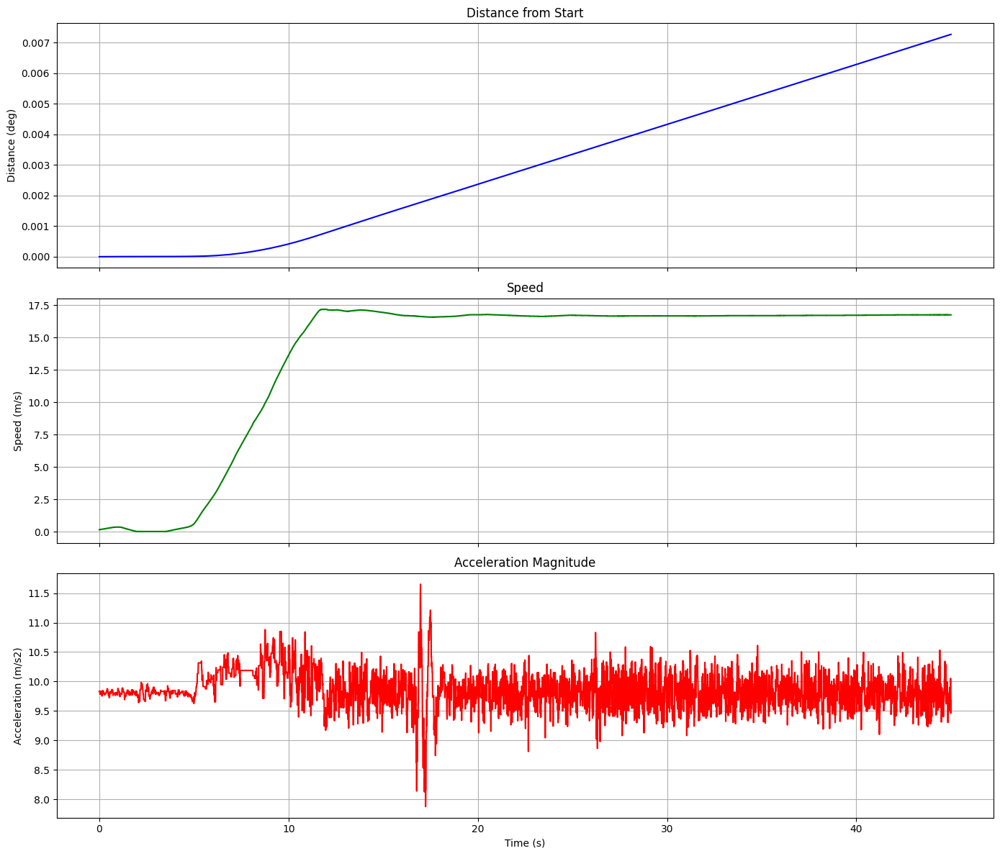

In [5]:
# Create a combined visualization of position, velocity, and acceleration
have_velocity = velocity_stats.get("available", False)
have_accel = accel_stats.get("available", False)

# Determine number of subplots needed
num_plots = 1 + (1 if have_velocity else 0) + (1 if have_accel else 0)

# Create figure with appropriate number of subplots
fig, axs = plt.subplots(num_plots, 1, figsize=(14, 4*num_plots), sharex=True)

# If we only have one plot, make axs an array for consistent indexing
if num_plots == 1:
    axs = [axs]

# Plot position (distance from start)
ax_idx = 0
distance = np.zeros_like(trajectory.time_diffs)
if len(trajectory.time_diffs) > 1:
    # Calculate cumulative distance from start
    for i in range(1, len(trajectory.time_diffs)):
        dx = trajectory.longitude[i] - trajectory.longitude[i-1]
        dy = trajectory.latitude[i] - trajectory.latitude[i-1]
        distance[i] = distance[i-1] + np.sqrt(dx**2 + dy**2)

axs[ax_idx].plot(trajectory.time_diffs, distance, 'b-')
axs[ax_idx].set_title('Distance from Start')
axs[ax_idx].set_ylabel('Distance (deg)')
axs[ax_idx].grid(True)

# Plot velocity if available
if have_velocity:
    ax_idx += 1
    velocity_time_diff = trajectory.velocity_time - trajectory.velocity_time[0]
    axs[ax_idx].plot(velocity_time_diff, trajectory.speed_3d, 'g-')
    axs[ax_idx].set_title('Speed')
    unit_label = velocity_stats["units"]["speed_3d"] if velocity_stats.get("units") else "units"
    axs[ax_idx].set_ylabel(f'Speed ({unit_label})')
    axs[ax_idx].grid(True)

# Plot acceleration if available
if have_accel:
    ax_idx += 1
    accel_time_diff = trajectory.acceleration_time - trajectory.acceleration_time[0]
    accel_magnitude = np.sqrt(
        trajectory.accel_x**2 + 
        trajectory.accel_y**2 + 
        trajectory.accel_z**2
    )
    axs[ax_idx].plot(accel_time_diff, accel_magnitude, 'r-')
    axs[ax_idx].set_title('Acceleration Magnitude')
    unit_label = accel_stats["units"]["accel_x"] if accel_stats.get("units") else "units"
    axs[ax_idx].set_ylabel(f'Acceleration ({unit_label})')
    axs[ax_idx].grid(True)

# Set common x-axis label
axs[-1].set_xlabel('Time (s)')

plt.tight_layout()
plt.show()

## Enhanced Animation with Velocity and Acceleration

In [6]:
# Enhanced Plotly animation including velocity and acceleration information
import plotly.graph_objects as go

# Get indices for frames
frame_indices = trajectory.get_points_for_visualization(max_frames=100)

# Create frames for animation
frames = []
for idx in frame_indices:
    # Create detailed hover text with all available data
    hover_text = "Position data"
    
    # Add velocity info if available
    if velocity_stats.get("available", False) and idx < len(trajectory.speed_3d):
        hover_text = (f"Speed: {trajectory.speed_3d[idx]:.2f}<br>"
                     f"North: {trajectory.vel_north[idx]:.2f}<br>"
                     f"East: {trajectory.vel_east[idx]:.2f}<br>"
                     f"Down: {trajectory.vel_down[idx]:.2f}")
    
    # Add acceleration info if available
    if accel_stats.get("available", False) and idx < len(trajectory.accel_x):
        accel_mag = np.sqrt(
            trajectory.accel_x[idx]**2 + 
            trajectory.accel_y[idx]**2 + 
            trajectory.accel_z[idx]**2
        )
        
        if "<br>" in hover_text:  # Already has velocity info
            hover_text += f"<br>Accel Mag: {accel_mag:.2f}<br>"
        else:
            hover_text = f"Accel Mag: {accel_mag:.2f}<br>"
            
        hover_text += (f"AccelX: {trajectory.accel_x[idx]:.2f}<br>"
                      f"AccelY: {trajectory.accel_y[idx]:.2f}<br>"
                      f"AccelZ: {trajectory.accel_z[idx]:.2f}")
    
    # Create title with all available info
    title = f"Time: +{trajectory.time_diffs[idx]:.2f} seconds"
    
    # Add speed to title if available
    if velocity_stats.get("available", False) and idx < len(trajectory.speed_3d):
        unit = velocity_stats.get("units", {}).get("speed_3d", "")
        title += f" | Speed: {trajectory.speed_3d[idx]:.2f} {unit}"
    
    # Add acceleration to title if available
    if accel_stats.get("available", False) and idx < len(trajectory.accel_x):
        accel_mag = np.sqrt(
            trajectory.accel_x[idx]**2 + 
            trajectory.accel_y[idx]**2 + 
            trajectory.accel_z[idx]**2
        )
        unit = accel_stats.get("units", {}).get("accel_x", "")
        title += f" | Accel: {accel_mag:.2f} {unit}"
    
    # For each frame, show all points up to the current one
    frames.append(
        go.Frame(
            data=[
                # The path so far
                go.Scattermap(
                    lat=trajectory.latitude[:idx+1],
                    lon=trajectory.longitude[:idx+1],
                    mode="lines",
                    line=dict(width=2, color="blue"),
                    opacity=0.7,
                    name="Path",
                    showlegend=False
                ),
                # The current position
                go.Scattermap(
                    lat=[trajectory.latitude[idx]],
                    lon=[trajectory.longitude[idx]],
                    mode="markers",
                    marker=dict(size=12, color="red"),
                    name="Current Position",
                    hovertext=hover_text,
                    hoverinfo="text",
                    showlegend=False
                )
            ],
            name=f"frame{idx}",
            layout=dict(title=title)
        )
    )

center_lat = np.mean(trajectory.latitude)
center_lon = np.mean(trajectory.longitude)

# Create the figure with initial data
fig = go.Figure(
    data=[
        go.Scattermap(
            lat=[trajectory.latitude[0]],
            lon=[trajectory.longitude[0]],
            mode="markers",
            marker=dict(size=12, color="red"),
            name="Starting Position"
        )
    ],
    frames=frames,
    layout=dict(
        title="Complete Movement Animation",
        mapbox=dict(
            style="open-street-map",
            center=dict(lat=center_lat, lon=center_lon),
            zoom=13
        ),
        updatemenus=[
            dict(
                type="buttons",
                showactive=False,
                buttons=[
                    dict(
                        label="Play",
                        method="animate",
                        args=[None, dict(
                            frame=dict(duration=50, redraw=True),
                            fromcurrent=True,
                            mode="immediate"
                        )]
                    ),
                    dict(
                        label="Pause",
                        method="animate",
                        args=[[None], dict(
                            frame=dict(duration=0, redraw=True),
                            mode="immediate"
                        )]
                    )
                ],
                direction="left",
                pad=dict(r=10, t=10),
                x=0.1,
                y=0,
            )
        ],
        height=600,
        margin=dict(l=0, r=0, t=50, b=0)
    )
)

fig.show()

# Enhanced Anomaly Detection Using Integrated Movement Data

This section demonstrates the improved anomaly detection system that integrates position, velocity, and acceleration data together.

In [7]:
# Import the updated anomaly detector
from trajectory_anomaly_detector import (
    TrajectoryQualityAnalyzer,
    IntegratedAnomalyDetector,
    AnomalyType
)

In [8]:
# Create an analyzer with customized thresholds
analyzer = TrajectoryQualityAnalyzer(
    detector_type="integrated",
    max_position_jump_m=5.0,       # 5 meters max jump
    max_velocity_mps=40.0,         # ~144 km/h max speed
    max_acceleration_mps2=10.0,    # 10 m/s² max acceleration (~1g)
    min_gps_jitter_m=0.1,          # 10cm minimum to consider as jitter
    max_vibration_hz=5.0           # 5 Hz maximum vibration frequency to detect
)

In [9]:
# Analyze the trajectory
trajectory.name = "FORDDAT2_Target45deg"
quality_report = analyzer.analyze_trajectory(trajectory)

# Display the report
print(quality_report.get_report_text())

Quality Report for Trajectory: FORDDAT2_Target45deg
Overall Quality Score: 0.90 out of 1.00
Status: GOOD

Summary Statistics:
  Acceleration Measurement Consistency: 9.4862
  Avg Acceleration (measured, m/s²): 9.8584
  Avg Velocity (derived, m/s): 13.8559
  Avg Velocity (measured, m/s): 13.7382
  Duration (s): 44.9994
  Max Acceleration (measured, m/s²): 11.6517
  Max Velocity (derived, m/s): 20.7011
  Max Velocity (measured, m/s): 17.1800
  Total Distance (m): 617.6721
  Total Points: 4501
  Velocity Measurement Consistency: 1.3772

Detected Anomalies:
  1. INCONSISTENT_MOVEMENT (Severity: 1.00)
     Inconsistency between measured and expected accelerations. Average difference of 9.49 m/s² and maximum difference of 12.56 m/s² detected.
     Location: Indices 0 to 4500
  2. ZIGZAG_PATTERN (Severity: 0.40)
     Zigzag pattern detected with 4 direction changes. Maximum bearing change of 90.0° over an average distance of only 0.01 meters. Confirmed by lateral acceleration patterns (max: 2

/Users/mgerard8/repos/oxts_quality_check/trajectory_anomaly_detector.py:174: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.



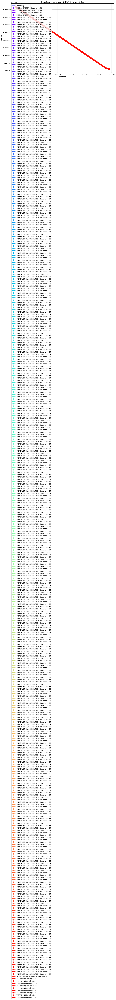

In [10]:
# Visualize any detected anomalies on the map
if quality_report.anomalies:
    anomaly_plot = quality_report.plot_anomalies(trajectory)
    #anomaly_plot
else:
    print("No anomalies detected in this trajectory.")

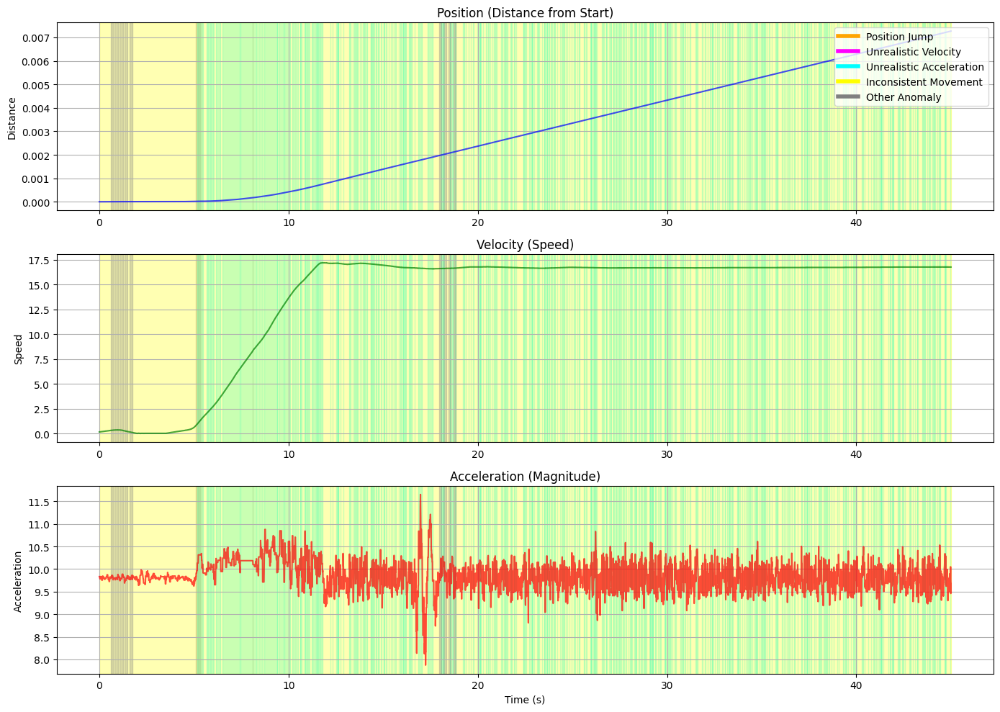

In [11]:
# Create a detailed visualization showing anomalies across position, velocity, and acceleration
if quality_report.anomalies:
    multivariate_plot = quality_report.plot_multivariate_anomalies(trajectory)
    multivariate_plot
else:
    print("No anomalies detected in this trajectory.")

## Analyzing Anomalies by Type

In [12]:
# Group anomalies by type
if quality_report.anomalies:
    anomaly_groups = {}
    for anomaly in quality_report.anomalies:
        anomaly_type = anomaly.anomaly_type.name
        if anomaly_type not in anomaly_groups:
            anomaly_groups[anomaly_type] = []
        anomaly_groups[anomaly_type].append(anomaly)
    
    # Display summary by type
    print(f"Found {len(quality_report.anomalies)} anomalies of {len(anomaly_groups)} different types:\n")
    
    for anomaly_type, anomalies in anomaly_groups.items():
        avg_severity = sum(a.severity for a in anomalies) / len(anomalies)
        print(f"{anomaly_type}: {len(anomalies)} occurrences, average severity {avg_severity:.2f}")
        
        # Print details of each anomaly
        for i, anomaly in enumerate(sorted(anomalies, key=lambda x: x.severity, reverse=True)):
            print(f"  {i+1}. Severity {anomaly.severity:.2f}: {anomaly.description}")
        print()
else:
    print("No anomalies detected in this trajectory.")

Found 421 anomalies of 4 different types:

ZIGZAG_PATTERN: 4 occurrences, average severity 0.22
  1. Severity 0.40: Zigzag pattern detected with 4 direction changes. Maximum bearing change of 90.0° over an average distance of only 0.01 meters. Confirmed by lateral acceleration patterns (max: 2.25 m/s²).
  2. Severity 0.24: Zigzag pattern detected with 4 direction changes. Maximum bearing change of 53.5° over an average distance of only 0.01 meters. Confirmed by lateral acceleration patterns (max: 2.32 m/s²).
  3. Severity 0.13: Zigzag pattern detected with 2 direction changes. Maximum bearing change of 57.6° over an average distance of only 0.13 meters. Confirmed by lateral acceleration patterns (max: 2.88 m/s²).
  4. Severity 0.12: Zigzag pattern detected with 2 direction changes. Maximum bearing change of 53.5° over an average distance of only 0.02 meters. Confirmed by lateral acceleration patterns (max: 2.27 m/s²).

UNREALISTIC_ACCELERATION: 407 occurrences, average severity 0.34
  

## Enhanced Anomaly Visualization with Heat Maps and Statistical Analysis

In [13]:
# Import necessary libraries for visualization
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from collections import Counter
from IPython.display import IFrame

# Set the style for better looking plots
sns.set_style("whitegrid")
plt.rcParams['figure.figsize'] = [12, 8]
plt.rcParams['figure.dpi'] = 100

In [14]:
# Function to create enhanced visualizations for anomaly analysis
from typing import Dict
import matplotlib.pyplot as plt
from trajectory_data import TrajectoryData
from trajectory_anomaly_detector import TrajectoryQualityReport
def enhanced_anomaly_visualization(self, trajectory: TrajectoryData) -> Dict[str, plt.Figure]:
    """Create enhanced visualizations for anomaly analysis.
    
    :param trajectory: The trajectory data to visualize
    :param report: The quality report containing anomalies
    :return: Dictionary of matplotlib figures with different visualizations
    """
    import numpy as np
    import matplotlib.pyplot as plt
    import seaborn as sns
    from matplotlib.colors import LinearSegmentedColormap
    from scipy.stats import gaussian_kde
    import folium
    from folium.plugins import HeatMap
    import pandas as pd
    from collections import Counter
    
    # Check if we have anomalies to visualize
    if not self.anomalies:
        fig, ax = plt.subplots()
        ax.text(0.5, 0.5, "No anomalies detected", ha='center', va='center')
        return {"no_anomalies": fig}
    
    # Create a dictionary to store all visualizations
    visualizations = {}
    
    # 1. Prepare data for visualizations
    # Create a DataFrame with all anomalies
    anomaly_data = []
    
    for anomaly in self.anomalies:
        # Get all points in the anomaly range
        for idx in range(anomaly.start_index, anomaly.end_index + 1):
            if idx < len(trajectory.latitude):
                entry = {
                    "latitude": trajectory.latitude[idx],
                    "longitude": trajectory.longitude[idx],
                    "type": anomaly.anomaly_type.name,
                    "severity": anomaly.severity,
                    "index": idx,
                    "time": trajectory.time[idx] if idx < len(trajectory.time) else 0
                }
                
                # Add velocity information if available
                if hasattr(trajectory, 'speed_3d') and idx < len(trajectory.speed_3d):
                    entry["speed"] = trajectory.speed_3d[idx]
                    entry["vel_north"] = trajectory.vel_north[idx] if idx < len(trajectory.vel_north) else 0
                    entry["vel_east"] = trajectory.vel_east[idx] if idx < len(trajectory.vel_east) else 0
                
                # Add acceleration information if available
                if hasattr(trajectory, 'accel_x') and idx < len(trajectory.accel_x):
                    entry["accel_x"] = trajectory.accel_x[idx]
                    entry["accel_y"] = trajectory.accel_y[idx]
                    entry["accel_z"] = trajectory.accel_z[idx]
                    entry["accel_magnitude"] = np.sqrt(
                        trajectory.accel_x[idx]**2 + 
                        trajectory.accel_y[idx]**2 + 
                        trajectory.accel_z[idx]**2
                    )
                
                anomaly_data.append(entry)
    
    if not anomaly_data:
        fig, ax = plt.subplots()
        ax.text(0.5, 0.5, "Anomaly data could not be processed", ha='center', va='center')
        return {"error": fig}
    
    anomalies_df = pd.DataFrame(anomaly_data)
    
    # Calculate distance from start for each point
    first_lat, first_lon = trajectory.latitude[0], trajectory.longitude[0]
    distances = []
    
    for idx in range(len(trajectory.latitude)):
        lat, lon = trajectory.latitude[idx], trajectory.longitude[idx]
        # Simple approximation for distance
        # 111,111 meters per degree of latitude
        # 111,111 * cos(latitude) meters per degree of longitude
        lat_dist = (lat - first_lat) * 111111
        lon_dist = (lon - first_lon) * (111111 * np.cos(np.radians(first_lat)))
        distances.append((lat_dist, lon_dist))
    
    distances = np.array(distances)
    
    # Add distance information to anomalies
    for i, row in anomalies_df.iterrows():
        idx = row['index']
        if idx < len(distances):
            anomalies_df.at[i, 'lat_dist'] = distances[idx, 0]
            anomalies_df.at[i, 'lon_dist'] = distances[idx, 1]
    
    # 2. Create heat map of anomaly frequency overlaid on trajectory
    fig1, ax1 = plt.subplots(figsize=(12, 10))
    
    # Plot the trajectory
    ax1.plot(trajectory.longitude, trajectory.latitude, 'k-', alpha=0.3, linewidth=1)
    
    # Create a 2D histogram for the heatmap
    if len(anomalies_df) > 5:  # Need at least a few points for meaningful density
        # Create a custom colormap from blue to red
        colors = [(0, 0, 0.8), (0, 0.8, 0.8), (0.8, 0.8, 0), (0.8, 0, 0)]
        cmap_name = 'anomaly_density'
        cm = LinearSegmentedColormap.from_list(cmap_name, colors, N=100)
        
        # Use kernel density estimation for smoother results
        try:
            # Create grid of points
            x_min, x_max = trajectory.longitude.min(), trajectory.longitude.max()
            y_min, y_max = trajectory.latitude.min(), trajectory.latitude.max()
            
            # Add some margin
            margin_x = (x_max - x_min) * 0.05
            margin_y = (y_max - y_min) * 0.05
            x_min -= margin_x
            x_max += margin_x
            y_min -= margin_y
            y_max += margin_y
            
            xx, yy = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
            positions = np.vstack([xx.ravel(), yy.ravel()])
            
            # Kernel density estimation
            values = np.vstack([anomalies_df['longitude'], anomalies_df['latitude']])
            kernel = gaussian_kde(values)
            f = np.reshape(kernel(positions).T, xx.shape)
            
            # Plot the kernel density estimate
            ax1.contourf(xx, yy, f, cmap=cm, alpha=0.7)
            
            # Add a color bar
            from mpl_toolkits.axes_grid1 import make_axes_locatable
            divider = make_axes_locatable(ax1)
            cax = divider.append_axes("right", size="5%", pad=0.05)
            plt.colorbar(ax1.contourf(xx, yy, f, cmap=cm, alpha=0), cax=cax, label="Anomaly Density")
        except Exception as e:
            # Fall back to scatter plot if KDE fails
            print(f"KDE failed: {e}. Falling back to scatter plot.")
            scatter = ax1.scatter(
                anomalies_df['longitude'], 
                anomalies_df['latitude'],
                c=anomalies_df['severity'],
                cmap='hot',
                alpha=0.6,
                s=50
            )
            plt.colorbar(scatter, label="Anomaly Severity")
    else:
        # For very few points, just use a scatter plot
        scatter = ax1.scatter(
            anomalies_df['longitude'], 
            anomalies_df['latitude'],
            c=anomalies_df['severity'],
            cmap='hot',
            alpha=0.6,
            s=50
        )
        plt.colorbar(scatter, label="Anomaly Severity")
    
    # Customize the plot
    ax1.set_title(f"Anomaly Heat Map for {self.trajectory_name}")
    ax1.set_xlabel("Longitude")
    ax1.set_ylabel("Latitude")
    ax1.grid(True, alpha=0.3)
    plt.tight_layout()
    
    visualizations["heatmap"] = fig1
    
    # 3. Create interactive Folium heatmap
    try:
        center_lat = np.mean(trajectory.latitude)
        center_lon = np.mean(trajectory.longitude)
        
        folium_map = folium.Map(location=[center_lat, center_lon], zoom_start=13)
        
        # Add trajectory line
        folium.PolyLine(
            locations=[[lat, lon] for lat, lon in zip(trajectory.latitude, trajectory.longitude)],
            color='blue',
            weight=2,
            opacity=0.7
        ).add_to(folium_map)
        
        # Add heat map layer
        heat_data = [[row.latitude, row.longitude, row.severity] for _, row in anomalies_df.iterrows()]
        HeatMap(heat_data, radius=15).add_to(folium_map)
        
        # Save to HTML for viewing in the notebook
        folium_filename = f"{self.trajectory_name}_heatmap.html"
        folium_map.save(folium_filename)
        print(f"Interactive heat map saved to {folium_filename}")
    except Exception as e:
        print(f"Folium map creation failed: {e}")
    
    # 4. Anomaly frequency by type
    fig2, ax2 = plt.subplots(figsize=(12, 6))
    
    # Count occurrences of each anomaly type
    anomaly_counts = Counter(anomalies_df['type'])
    
    # Sort by frequency
    types, counts = zip(*sorted(anomaly_counts.items(), key=lambda x: x[1], reverse=True))
    
    # Create bar chart
    bars = ax2.bar(types, counts, color='skyblue')
    
    # Add count labels on top of bars
    for i, bar in enumerate(bars):
        height = bar.get_height()
        ax2.text(bar.get_x() + bar.get_width()/2., height + 0.1,
                f'{counts[i]}', ha='center', va='bottom')
    
    # Customize plot
    ax2.set_title("Frequency of Anomaly Types")
    ax2.set_xlabel("Anomaly Type")
    ax2.set_ylabel("Count")
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    
    visualizations["frequency"] = fig2
    
    # 5. Distribution of anomalies by lateral and longitudinal distance
    if 'lat_dist' in anomalies_df.columns and 'lon_dist' in anomalies_df.columns:
        fig3, (ax3a, ax3b) = plt.subplots(1, 2, figsize=(14, 6))
        
        # Color by anomaly type
        anomaly_types = anomalies_df['type'].unique()
        colors = plt.cm.tab10(np.linspace(0, 1, len(anomaly_types)))
        color_map = dict(zip(anomaly_types, colors))
        
        # Lateral distance distribution
        for atype in anomaly_types:
            subset = anomalies_df[anomalies_df['type'] == atype]
            sns.kdeplot(data=subset, x='lat_dist', ax=ax3a, label=atype, color=color_map[atype])
        
        ax3a.set_title("Lateral Distance Distribution of Anomalies")
        ax3a.set_xlabel("Lateral Distance from Start (m)")
        ax3a.set_ylabel("Density")
        ax3a.grid(True, alpha=0.3)
        
        # Longitudinal distance distribution
        for atype in anomaly_types:
            subset = anomalies_df[anomalies_df['type'] == atype]
            sns.kdeplot(data=subset, x='lon_dist', ax=ax3b, label=atype, color=color_map[atype])
        
        ax3b.set_title("Longitudinal Distance Distribution of Anomalies")
        ax3b.set_xlabel("Longitudinal Distance from Start (m)")
        ax3b.set_ylabel("Density")
        ax3b.grid(True, alpha=0.3)
        
        # Create shared legend
        handles, labels = ax3a.get_legend_handles_labels()
        fig3.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 0.05), ncol=3)
        
        # Remove duplicate legends - THIS IS WHERE THE ERROR OCCURS
        if ax3a.get_legend() is not None:  # Add this check
            ax3a.get_legend().remove()
        if ax3b.get_legend() is not None:  # Add this check
            ax3b.get_legend().remove()

        
        plt.tight_layout()
        plt.subplots_adjust(bottom=0.15)  # Make space for the common legend
        
        visualizations["distance_distribution"] = fig3
    
    # 6. Create velocity and acceleration distributions if available
    if 'speed' in anomalies_df.columns:
        # Velocity distribution by anomaly type
        fig4, ax4 = plt.subplots(figsize=(10, 6))
        
        for atype in anomaly_types:
            subset = anomalies_df[anomalies_df['type'] == atype]
            if not subset.empty:
                sns.kdeplot(data=subset, x='speed', ax=ax4, label=atype, color=color_map[atype])
        
        ax4.set_title("Velocity Distribution by Anomaly Type")
        ax4.set_xlabel("Speed (m/s)")
        ax4.set_ylabel("Density")
        ax4.grid(True, alpha=0.3)
        ax4.legend()
        
        plt.tight_layout()
        visualizations["velocity_distribution"] = fig4
    
    if 'accel_magnitude' in anomalies_df.columns:
        # Acceleration distribution by anomaly type
        fig5, ax5 = plt.subplots(figsize=(10, 6))
        
        for atype in anomaly_types:
            subset = anomalies_df[anomalies_df['type'] == atype]
            if not subset.empty:
                sns.kdeplot(data=subset, x='accel_magnitude', ax=ax5, label=atype, color=color_map[atype])
        
        ax5.set_title("Acceleration Distribution by Anomaly Type")
        ax5.set_xlabel("Acceleration Magnitude (m/s²)")
        ax5.set_ylabel("Density")
        ax5.grid(True, alpha=0.3)
        ax5.legend()
        
        plt.tight_layout()
        visualizations["acceleration_distribution"] = fig5
    
    # 7. Create a 2D scatter plot of anomalies by lat/lon distance colored by type
    if 'lat_dist' in anomalies_df.columns and 'lon_dist' in anomalies_df.columns:
        fig6, ax6 = plt.subplots(figsize=(10, 8))
        
        for atype, color in zip(anomaly_types, colors):
            subset = anomalies_df[anomalies_df['type'] == atype]
            ax6.scatter(subset['lon_dist'], subset['lat_dist'], c=[color], label=atype, alpha=0.7, s=50)
        
        # Plot trajectory path in distance coordinates
        path_x = distances[:, 1]  # lon_dist
        path_y = distances[:, 0]  # lat_dist
        ax6.plot(path_x, path_y, 'k--', alpha=0.3, linewidth=1)
        
        # Mark start and end
        ax6.scatter([path_x[0]], [path_y[0]], c='green', s=100, marker='^', label='Start')
        ax6.scatter([path_x[-1]], [path_y[-1]], c='red', s=100, marker='s', label='End')
        
        ax6.set_title("Spatial Distribution of Anomalies")
        ax6.set_xlabel("Longitudinal Distance (m)")
        ax6.set_ylabel("Lateral Distance (m)")
        ax6.grid(True, alpha=0.3)
        ax6.legend()
        ax6.axis('equal')  # Equal scaling
        
        plt.tight_layout()
        visualizations["spatial_distribution"] = fig6
    
    # 8. Create a severity distribution plot
    fig7, ax7 = plt.subplots(figsize=(10, 6))
    
    sns.boxplot(data=anomalies_df, x='type', y='severity', ax=ax7)
    ax7.set_title("Anomaly Severity by Type")
    ax7.set_xlabel("Anomaly Type")
    ax7.set_ylabel("Severity")
    plt.xticks(rotation=45, ha='right')
    
    plt.tight_layout()
    visualizations["severity_distribution"] = fig7
    
    # Return all visualizations
    return visualizations


In [15]:
# Add the function to the TrajectoryQualityReport class for convenience
# from types import MethodType
# from trajectory_anomaly_detector import TrajectoryQualityReport

# # Attach the function to the class
# TrajectoryQualityReport.enhanced_visualizations = MethodType(enhanced_anomaly_visualization, None)

In [16]:
# Add the function to the TrajectoryQualityReport class for convenience
from trajectory_anomaly_detector import TrajectoryQualityReport

# Simply assign the function directly to the class
TrajectoryQualityReport.enhanced_visualizations = enhanced_anomaly_visualization

Interactive heat map saved to FORDDAT2_Target45deg_heatmap.html
Found 421 anomalies in the trajectory.



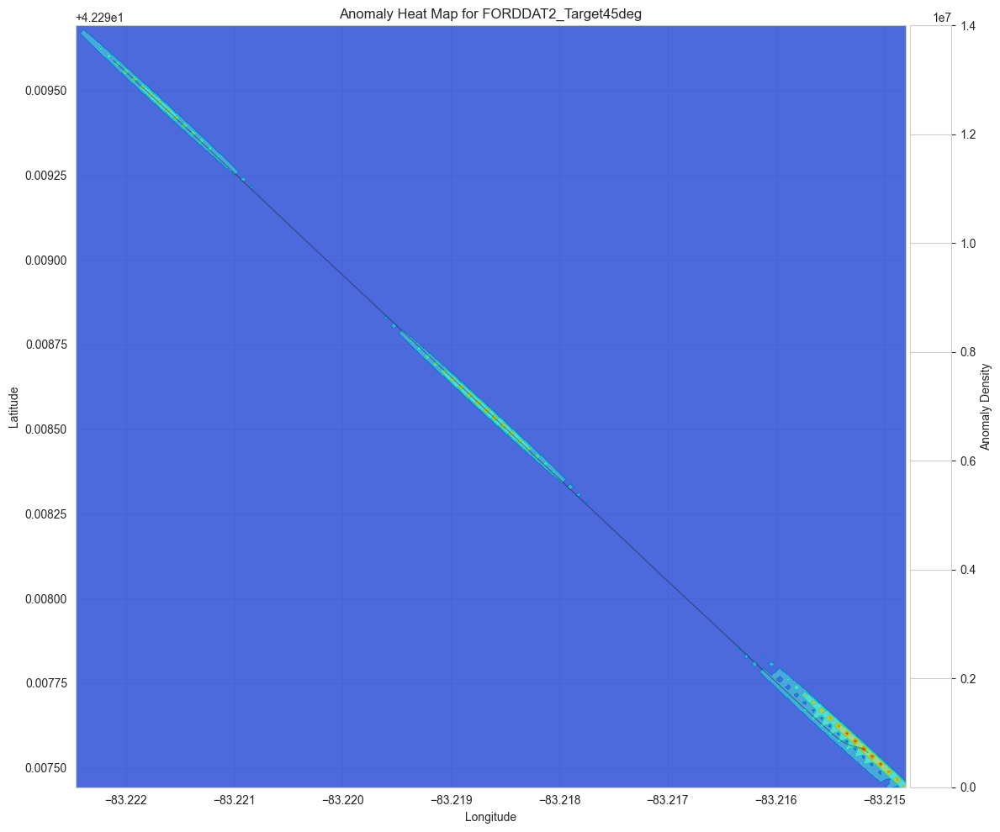

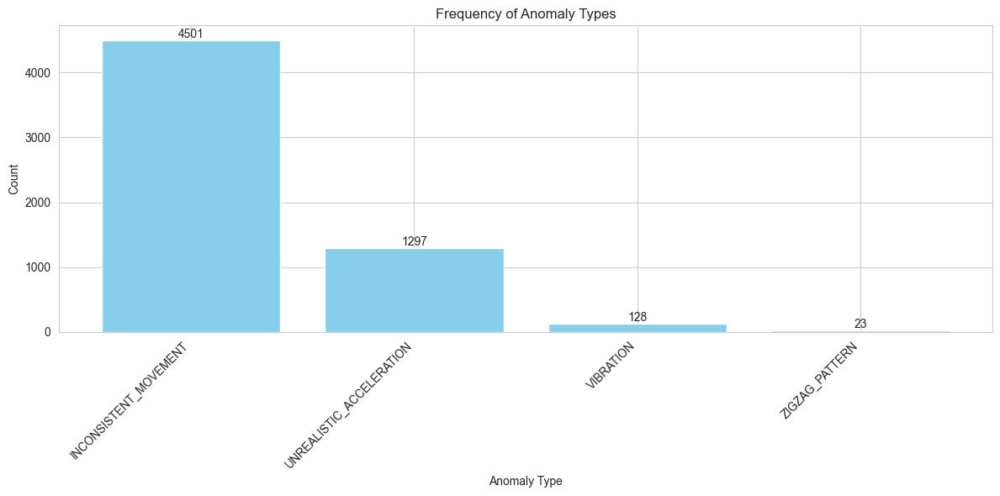

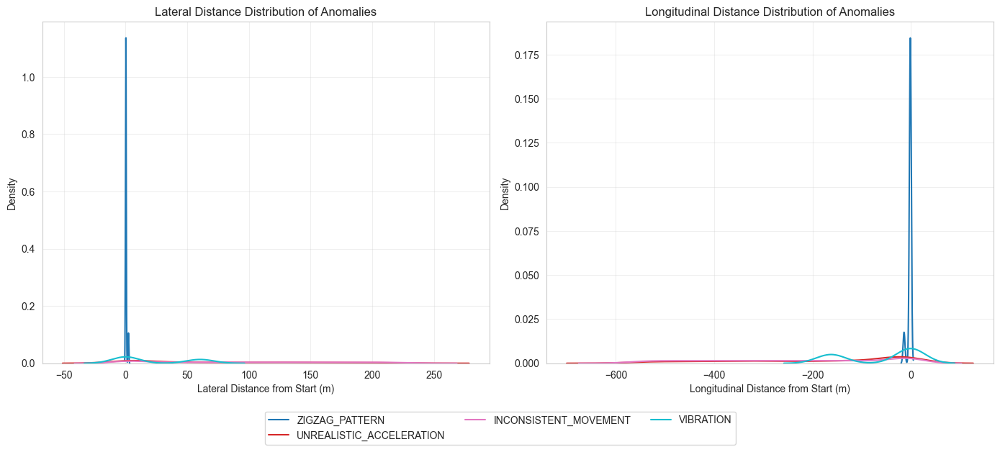

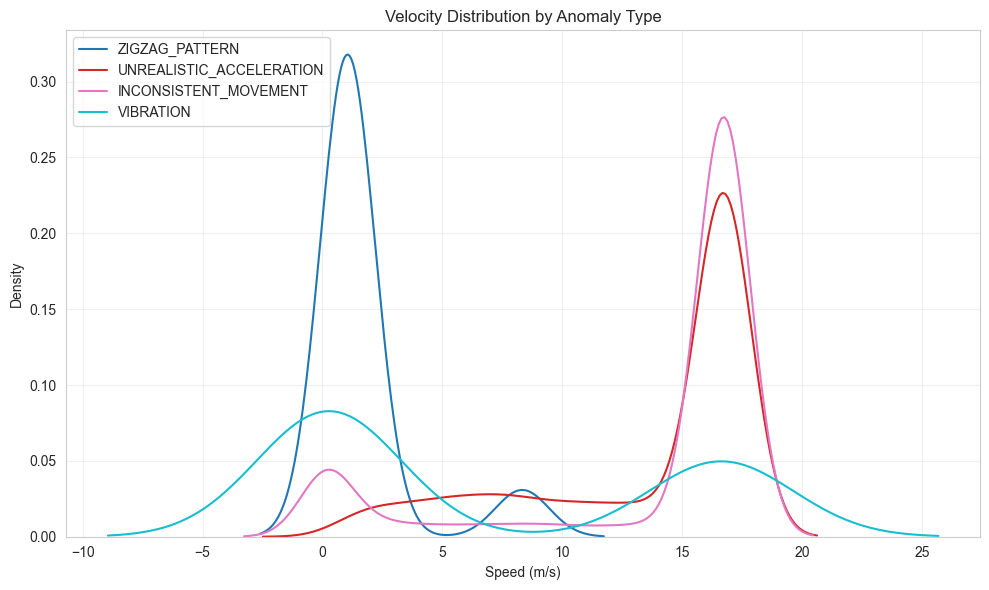

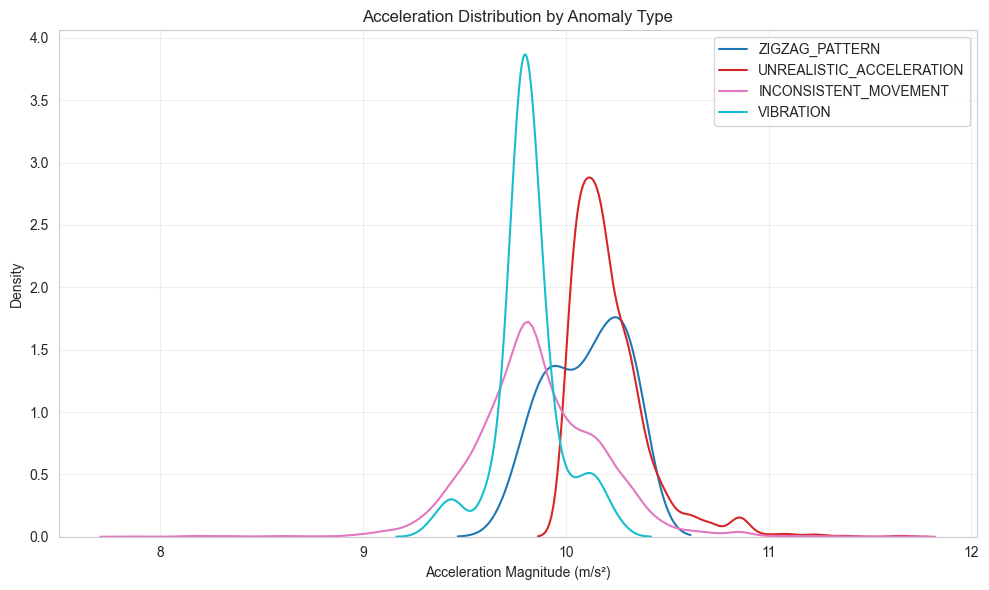

...

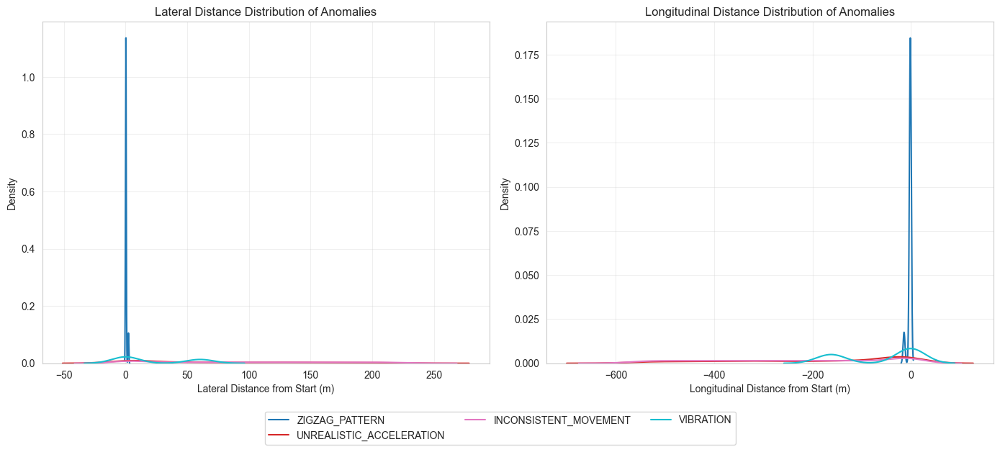

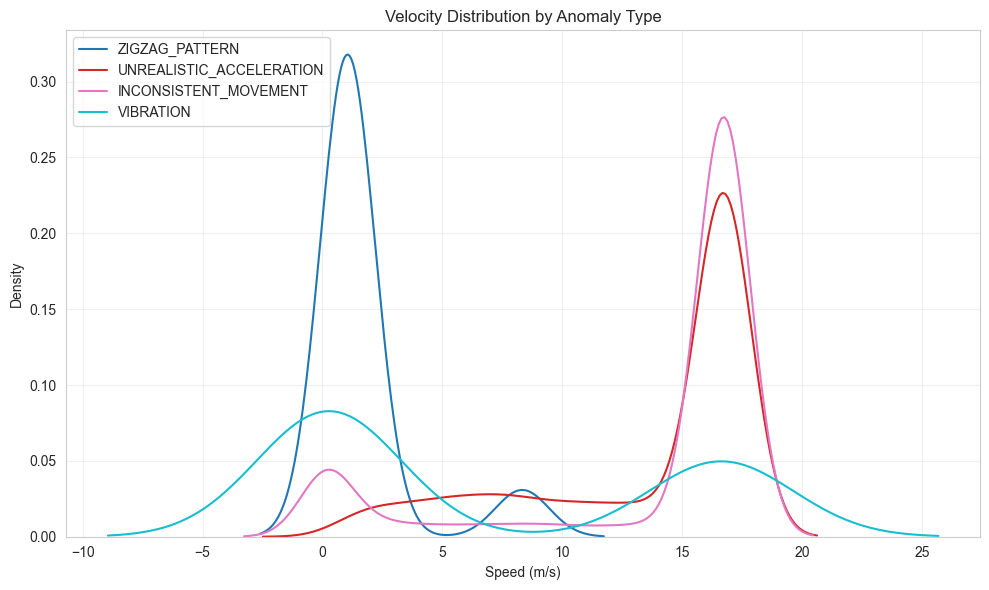

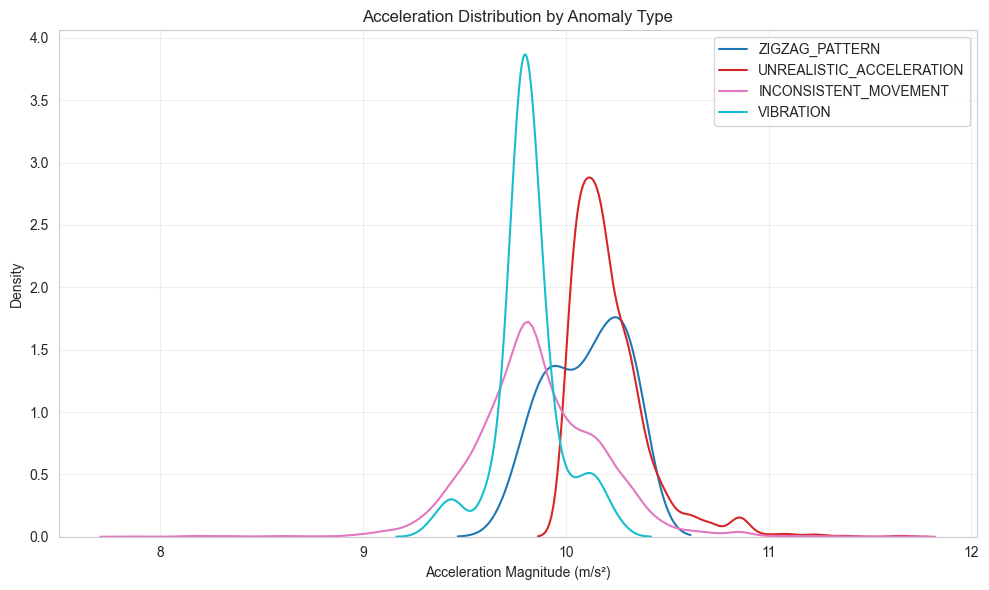

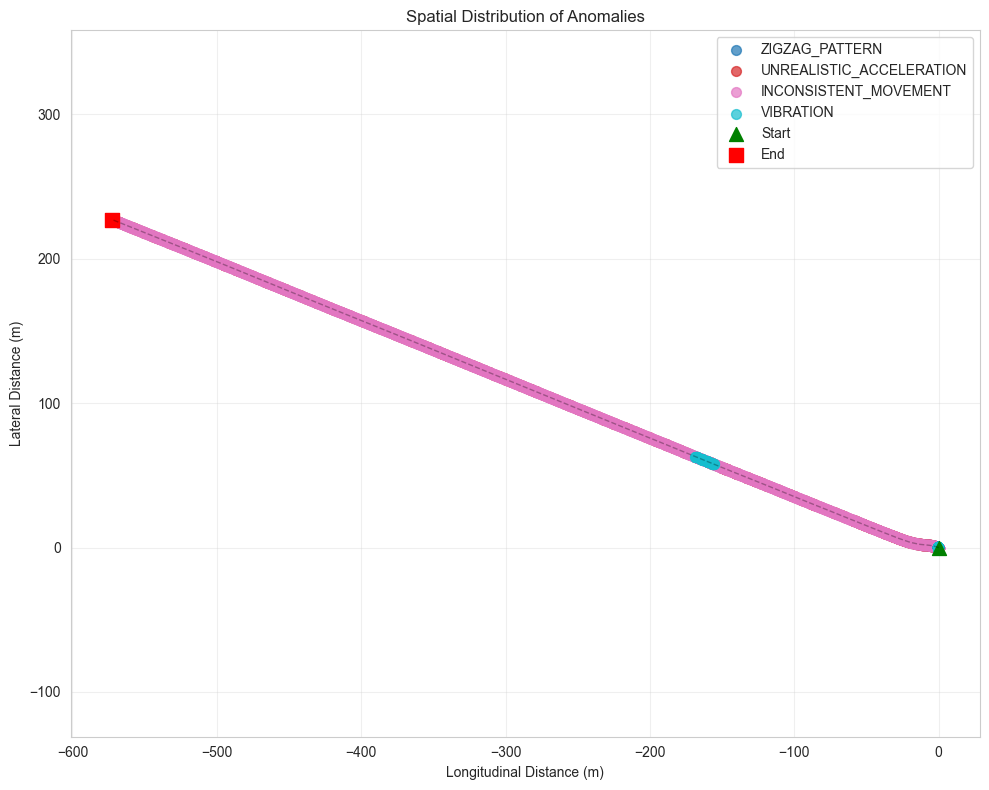

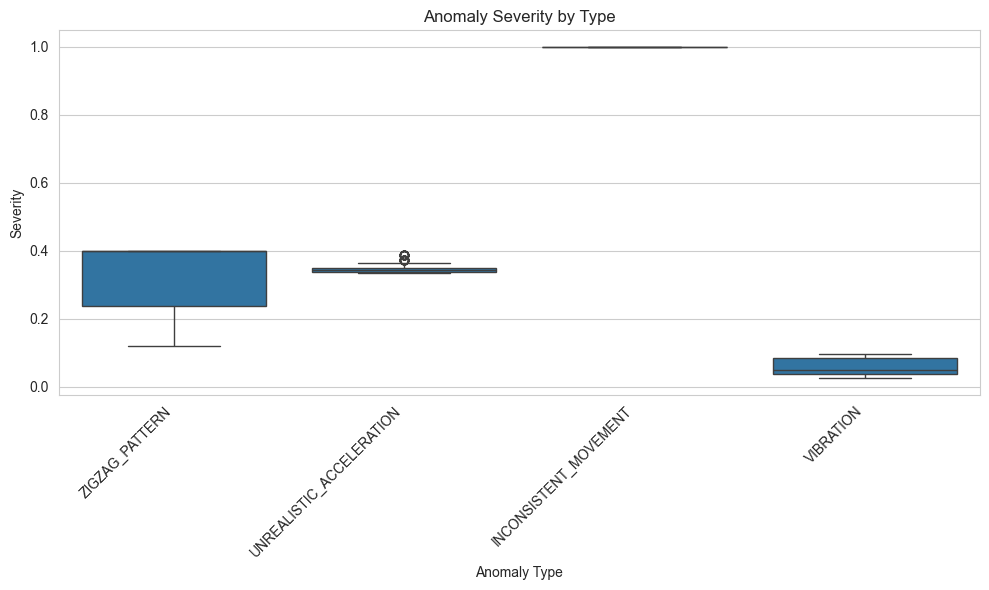

In [17]:
# Generate and display enhanced visualizations
# Generate and display enhanced visualizations
if quality_report.anomalies:
    vis_figures = quality_report.enhanced_visualizations(trajectory)
    
    # Display each visualization
    print(f"Found {len(quality_report.anomalies)} anomalies in the trajectory.\n")
    
    # Heat map
    if "heatmap" in vis_figures:
        display(vis_figures["heatmap"])
    
    # Frequency of anomaly types
    if "frequency" in vis_figures:
        display(vis_figures["frequency"])
    
    # Display interactive heat map if available
    try:
        folium_filename = f"{quality_report.trajectory_name}_heatmap.html"
        display(IFrame(folium_filename, width=900, height=600))
    except:
        print("Interactive heat map not available for display in the notebook.")
    
    # Distance distribution
    if "distance_distribution" in vis_figures:
        display(vis_figures["distance_distribution"])
    
    # Velocity distribution
    if "velocity_distribution" in vis_figures:
        display(vis_figures["velocity_distribution"])
    
    # Acceleration distribution
    if "acceleration_distribution" in vis_figures:
        display(vis_figures["acceleration_distribution"])
    
    # Spatial distribution
    if "spatial_distribution" in vis_figures:
        display(vis_figures["spatial_distribution"])
    
    # Severity distribution
    if "severity_distribution" in vis_figures:
        display(vis_figures["severity_distribution"])
else:
    print("No anomalies detected in this trajectory.")

In [18]:
# Import the TrajectoryAnalyzer
from trajectory_analysis import TrajectoryAnalyzer

# Create and display the enhanced summary tables
if quality_report.anomalies:
    # Create measurement statistics table
    stats_table = TrajectoryAnalyzer.create_measurement_statistics_table(trajectory, quality_report)
    display(stats_table)
    
    # Create anomaly summary table
    anomaly_table = TrajectoryAnalyzer.create_anomaly_summary_table(quality_report)
    display(anomaly_table)
    
    # Create advanced anomaly clustering visualization
    try:
        clustering_fig = TrajectoryAnalyzer.create_advanced_anomaly_clustering(trajectory, quality_report)
        display(clustering_fig)
    except Exception as e:
        print(f"Advanced clustering visualization could not be generated: {e}")
else:
    print("No anomalies detected in this trajectory.")

,Measurement,Min,Max,Mean,Std Dev,Has Outliers,Unit
0,Position (distance),0.0000,616.0549,253.7917,198.8699,False,meters
1,Derived Velocity,-0.8967,19.9116,13.8223,6.0883,False,m/s
2,Measured Speed,0.0000,17.1800,13.7382,5.8606,False,m/s
3,North Velocity,-0.0100,6.4400,5.0446,2.3352,False,m/s
4,East Velocity,-15.9400,0.0200,-12.7667,5.4041,False,m/s
5,Down Velocity,-0.1000,0.1800,0.0354,0.0237,True,m/s
6,Acceleration Magnitude,7.8746,11.6517,9.8584,0.3063,True,m/s²
7,X Acceleration,-0.5300,3.5900,0.3839,0.9461,True,m/s²
8,Y Acceleration,-1.1800,2.1600,-0.1327,0.3272,True,m/s²
9,Z Acceleration,-11.6500,-7.8700,-9.7999,0.2771,True,m/s²


,Anomaly Type,Count,Frequency (%),Avg Severity,Max Severity,Quality Impact
0,UNREALISTIC_ACCELERATION,407,96.7%,0.340,0.388,LOW
1,VIBRATION,9,2.1%,0.053,0.097,LOW
2,ZIGZAG_PATTERN,4,1.0%,0.221,0.400,LOW
3,INCONSISTENT_MOVEMENT,1,0.2%,1.000,1.000,HIGH
4,OVERALL QUALITY,421,100.0%,0.403,1.000,GOOD


Advanced clustering visualization could not be generated: type object 'TrajectoryAnalyzer' has no attribute 'create_advanced_anomaly_clustering'


In [19]:
# Create and display the enhanced summary tables
if quality_report.anomalies:
    # Create enhanced measurement statistics table with outlier severity and anomaly information
    stats_table = TrajectoryAnalyzer.create_enhanced_measurement_statistics_table(trajectory, quality_report)
    display(stats_table)
    
    # Create enhanced anomaly summary table with more detailed information
    anomaly_table = TrajectoryAnalyzer.create_enhanced_anomaly_summary_table(quality_report)
    display(anomaly_table)
    
    # Create advanced anomaly clustering visualization (if available)
    # ... rest of your code
else:
    print("No anomalies detected in this trajectory.")

Measurement,Min,Max,Mean,Std Dev,Has Outliers,Outlier Severity,Related Anomalies,Avg Anomaly Score,Unit
Position (distance),0.0000,616.0549,253.7917,198.8699,NO,0.00,ZIGZAG_PATTERN,0.40,meters
Derived Velocity,-0.8967,19.9116,13.8223,6.0883,NO,0.00,INCONSISTENT_MOVEMENT,1.00,m/s
Measured Speed,0.0000,17.1800,13.7382,5.8606,NO,0.00,INCONSISTENT_MOVEMENT,1.00,m/s
North Velocity,-0.0100,6.4400,5.0446,2.3352,NO,0.00,INCONSISTENT_MOVEMENT,1.00,m/s
East Velocity,-15.9400,0.0200,-12.7667,5.4041,NO,0.00,INCONSISTENT_MOVEMENT,1.00,m/s
Down Velocity,-0.1000,0.1800,0.0354,0.0237,YES,0.45,INCONSISTENT_MOVEMENT,1.00,m/s
Acceleration Magnitude,7.8746,11.6517,9.8584,0.3063,YES,0.39,"INCONSISTENT_MOVEMENT, VIBRATION, UNREALISTIC_ACCELERATION",0.46,m/s²
X Acceleration,-0.5300,3.5900,0.3839,0.9461,YES,0.32,"INCONSISTENT_MOVEMENT, VIBRATION, UNREALISTIC_ACCELERATION",0.46,m/s²
Y Acceleration,-1.1800,2.1600,-0.1327,0.3272,YES,0.47,"INCONSISTENT_MOVEMENT, VIBRATION, UNREALISTIC_ACCELERATION",0.46,m/s²
Z Acceleration,-11.6500,-7.8700,-9.7999,0.2771,YES,0.43,"INCONSISTENT_MOVEMENT, VIBRATION, UNREALISTIC_ACCELERATION",0.46,m/s²


Anomaly Type,Count,Frequency (%),Avg Severity,Max Severity,Avg Duration,Quality Impact,Description
UNREALISTIC_ACCELERATION,407,96.7%,0.340,0.388,3.2 points,LOW,Acceleration rates beyond physical capabilities
VIBRATION,9,2.1%,0.053,0.097,14.2 points,LOW,High-frequency oscillations in acceleration
ZIGZAG_PATTERN,4,1.0%,0.221,0.400,5.8 points,LOW,Erratic back-and-forth movements indicating noise
INCONSISTENT_MOVEMENT,1,0.2%,1.000,1.000,4501.0 points,HIGH,"Mismatches between position, velocity, and acceleration"
OVERALL QUALITY,421,100.0%,0.403,1.000,1131.0 points,GOOD,Overall quality score: 0.90


In [20]:
# # Import libraries
# import glob
# import os
# from trajectory_analysis import TrajectoryAnalyzer

# # Find all MATLAB files in a directory
# data_directory = "./"  # Change to your data directory
# mat_files = glob.glob(f"{data_directory}/*.mat")

# # Create and display the summary table
# summary_table = TrajectoryAnalyzer.create_trajectory_quality_summary_table(mat_files)
# display(summary_table)


In [21]:
# Import libraries
import glob
from trajectory_analysis import TrajectoryAnalyzer
import os

# Find all MATLAB files in a directory
data_directory = "./"  # Change to your data directory
mat_files = glob.glob(f"{data_directory}/*.mat")

# Create and display the summary table
summary_table = TrajectoryAnalyzer.create_trajectory_quality_summary_table(mat_files)
display(summary_table)


In [25]:
# Example usage with multiple directories:
# directories = [
#     "./data_dir1",
#     "./data_dir2",
#     "./data_dir3"
# ]

directories =[
    "./", 
    "/Users/mgerard8/Library/CloudStorage/OneDrive-azureford/DAT3 Internal Access - Data Log/301W021/Max detection Range/Target at 60 deg/", 
    "/Users/mgerard8/Library/CloudStorage/OneDrive-azureford/DAT3 Internal Access - Data Log/301W021/Max detection Range/Target at 90 deg/",
    "/Users/mgerard8/Library/CloudStorage/OneDrive-azureford/DAT3 Internal Access - Data Log/301W021/Max detection Range/Target In lane/"
]

# Create and display the summary table
summary_table = TrajectoryAnalyzer.create_trajectory_quality_summary_table(directories)
display(summary_table)


File Name,Anomaly Status,Average Quality Score,Min Quality Score,Max Quality Score,Std Deviation
FORDDAT2_20250414_Target45deg_Tilt+ive_60kph_100112_001.mat,"Error: ""Required key 'TargetLatitudeLongitude' not found in MATLAB file""",0.000,0.000,0.000,0.000
FORDDAT2_20250414_Target45deg_Tilt-ive_60kph_094221_001.mat,"Error: ""Required key 'TargetLatitudeLongitude' not found in MATLAB file""",0.000,0.000,0.000,0.000
FORDDAT2_20250414_Target45deg_Tilt-ive_60kph__093931_002.mat,No Critical Anomaly,0.965,0.900,0.998,0.014
FORDDAT2_20250414_Target45deg_Tilt+ive_60kph_100010_001.mat,No Critical Anomaly,0.966,0.900,0.996,0.005
FORDDAT2_20250414_Target45deg_Tilt-ive_60kph__093931_001.mat,No Critical Anomaly,0.967,0.900,0.998,0.006
File Name,Anomaly Status,Average Quality Score,Min Quality Score,Max Quality Score,Std Deviation
FORDDAT2_20250414_Target60deg_Tilt+ive_60kph_100501_001.mat,No Critical Anomaly,0.966,0.900,0.996,0.005
FORDDAT2_20250414_Target60deg_Tilt+ive_60kph_100605_001.mat,No Critical Anomaly,0.966,0.900,0.996,0.006
FORDDAT2_20250414_Target60deg_Tilt-ive_60kph_094931_001.mat,No Critical Anomaly,0.966,0.900,0.999,0.006
FORDDAT2_20250414_Target60deg_Tilt-ive_60kph_094817_001.mat,No Critical Anomaly,0.966,0.900,0.998,0.006
